# Notebook for model training

### Training Flow

Load Training Data:
- Load set of input data and label files
- Prefilter positive set only to rule out heavily-masked patches
- Create train/test set
- Define augmentation parameters

Train Model:
- Define model architecture
- Compile model
- Train and evaluate model
- Save model

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from datetime import date
from datetime import datetime
import time
import os
import pickle
import sys

import json

import pandas as pd
import io
from contextlib import redirect_stdout
import re
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from tensorflow import keras
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.models import Model
from tensorflow.keras.models import load_model

from keras.layers import Input, Dense, Flatten, Dropout, Conv2D
from keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tqdm.notebook import tqdm

parent_dir = os.path.split(os.getcwd())[0]
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)

from scripts import dl_utils
from scripts import viz_tools
from scripts import models

import gc
from tensorflow.keras import backend as K

import tensorflow as tf
import warnings

os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
warnings.filterwarnings('ignore')
tf.get_logger().setLevel('ERROR')

2024-09-27 10:15:42.344063: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-09-27 10:15:42.365462: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-27 10:15:42.365485: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-27 10:15:42.366173: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-09-27 10:15:42.370027: I tensorflow/core/platform/cpu_feature_guar

## Open Data

In [3]:
resolution = 48

data_files = [
    "amazonas_2020_thresh_0.5_2_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "amazonas_2020_thresh_0.8_sumbsample_3_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "MinesPos2018-2020Sentinel_points_2019-01-01_2020-01-01_patch_arrays.pkl",
    "bolivar_2020_thresh_0.8_sumbsample_5_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "full_amazon_v9_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.4_amazon_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.6_amazon_thresh_0.8_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.0_bolivar_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "riverbank_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "bolivar_2020_thresh_0.8_1_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.1.1_bolivar_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.1_bolivar_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.4_amazonas_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.4_amazon_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.6_amazon_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.6_amazon_negatives_v2_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v3.1_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl",
    "amazon_all_48px_v3.1_2023_positives_0.999_2023-01-01_2024-01-01_patch_arrays.pkl",
    "v3.2_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl",
    "v3.3_2023_positives_2023-01-01_2024-01-01_patch_arrays.pkl",
    "v3.4_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl",
    "v3.5_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl",
    "v3.6_2023_positives_2023-01-01_2024-01-01_patch_arrays.pkl"
    
    ]

label_files = [
    "amazonas_2020_thresh_0.5_2_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "amazonas_2020_thresh_0.8_sumbsample_3_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "MinesPos2018-2020Sentinel_points_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "bolivar_2020_thresh_0.8_sumbsample_5_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "full_amazon_v9_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.4_amazon_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.6_amazon_thresh_0.8_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.0_bolivar_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "riverbank_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "bolivar_2020_thresh_0.8_1_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.1.1_bolivar_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.1_bolivar_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.4_amazonas_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.4_amazon_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.6_amazon_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.6_amazon_negatives_v2_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v3.1_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl",
    "amazon_all_48px_v3.1_2023_positives_0.999_2023-01-01_2024-01-01_patch_array_labels.pkl",
    "v3.2_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl",
    "v3.3_2023_positives_2023-01-01_2024-01-01_patch_array_labels.pkl",
    "v3.4_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl",
    "v3.5_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl",
    "v3.6_2023_positives_2023-01-01_2024-01-01_patch_array_labels.pkl"
    
    
]

patches = []
labels = []

data_dir = os.path.join('..', 'data', 'training_data', f"{resolution}_px")

for data, label in tqdm(zip(data_files, label_files), total=len(data_files)):
    with open(os.path.join(data_dir, data), 'rb') as f:
        data = pickle.load(f)
        for elem in data:
            #patch = dl_utils.pad_patch(elem, resolution)
            patches.append(elem)
    with open(os.path.join(data_dir, label), 'rb') as f:
        label = pickle.load(f)
        labels = np.concatenate((labels, label))

patches = np.array(patches)
negative_patches = patches[labels == 0]
positive_patches = patches[labels == 1]

print(len(patches), "samples loaded")
print(sum(labels == 1), "positive samples")
print(sum(labels == 0), "negative samples")

  0%|          | 0/23 [00:00<?, ?it/s]

4549 samples loaded
1891 positive samples
2658 negative samples


  0%|          | 0/64 [00:00<?, ?it/s]

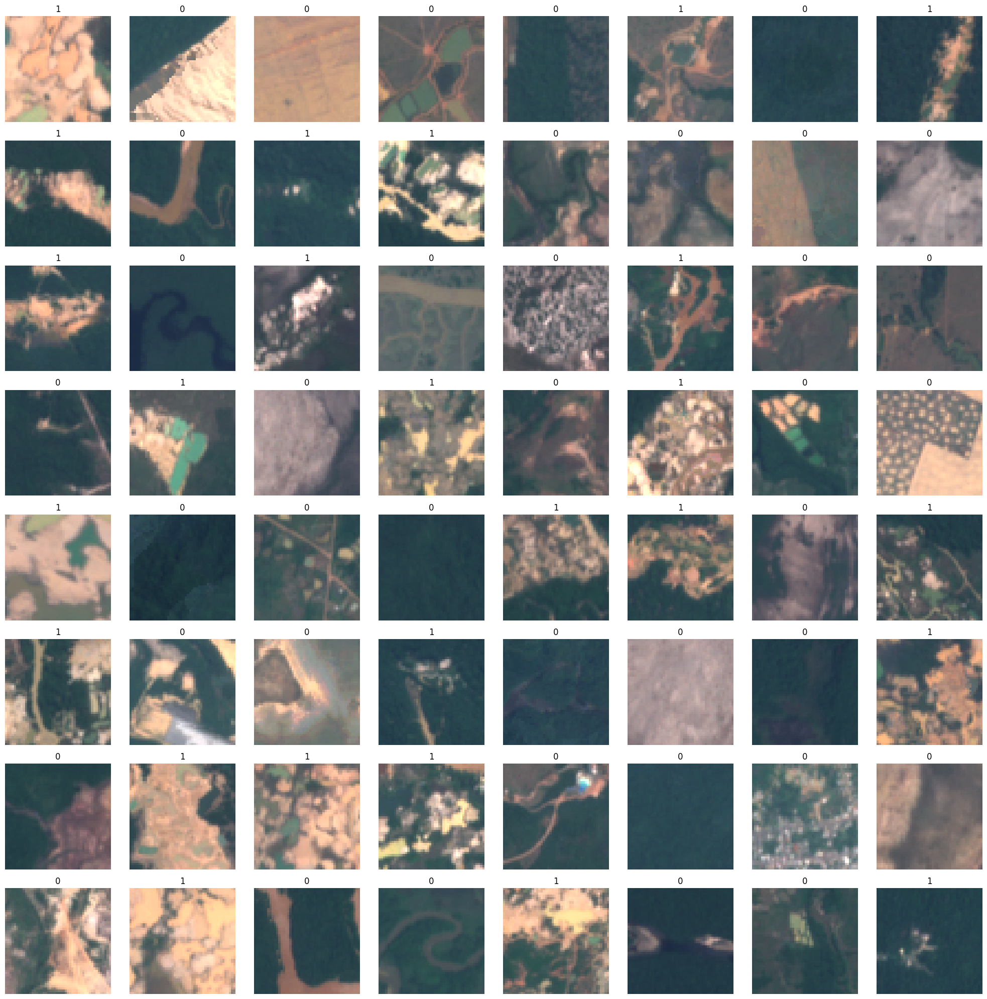

In [4]:
num_samples = 64
indices = np.random.randint(0, len(patches), num_samples)
viz_tools.plot_image_grid(patches[indices], labels=[int(label) for label in labels[indices]])

In [5]:
def filter_black(data, mask_limit=0.1, return_rejects=False):
    masked_fraction = np.array([np.sum(np.mean(patch, axis=-1) < 10) / np.size(np.mean(patch, axis=-1)) for patch in data])
    filtered_data = data[masked_fraction < mask_limit]
    print(f"{len(filtered_data) / len(data) :.1%} of data below brightness limit")
    if return_rejects:
        rejected_data = data[masked_fraction >= mask_limit]
        return filtered_data, rejected_data
    else:
        return filtered_data

99.9% of data below brightness limit


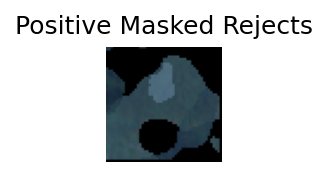

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.7546666666666666].


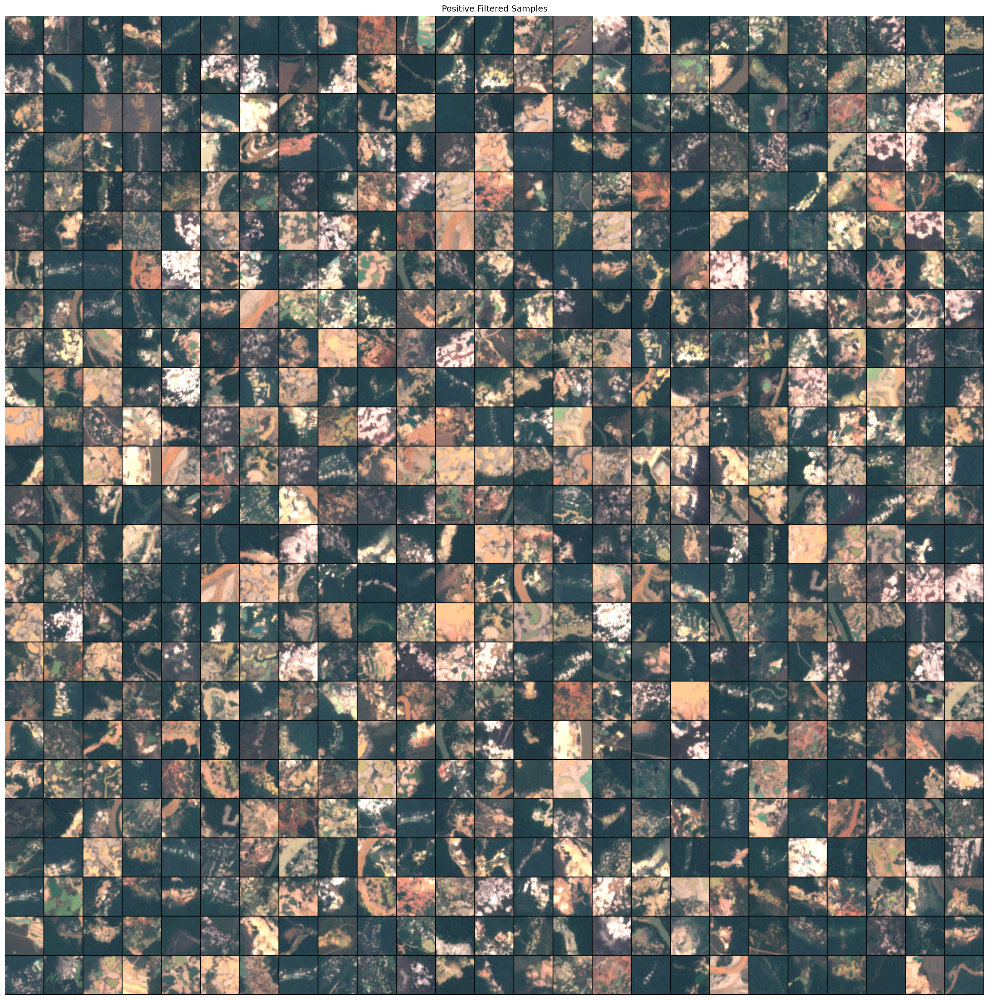

In [6]:
# Filter positive pixels that are masked beyond a threshold. Don't want to give positive examples of cloud-masked patches
filtered_positives, positive_rejects = filter_black(positive_patches, mask_limit = 0.1, return_rejects=True)
if len(positive_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(positive_rejects), num_samples)
    viz_tools.plot_numpy_grid(positive_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Positive Masked Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_positives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_positives[indices,:,:,3:0:-1] / 3000)
plt.title('Positive Filtered Samples')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..2.401].


100.0% of data below brightness limit


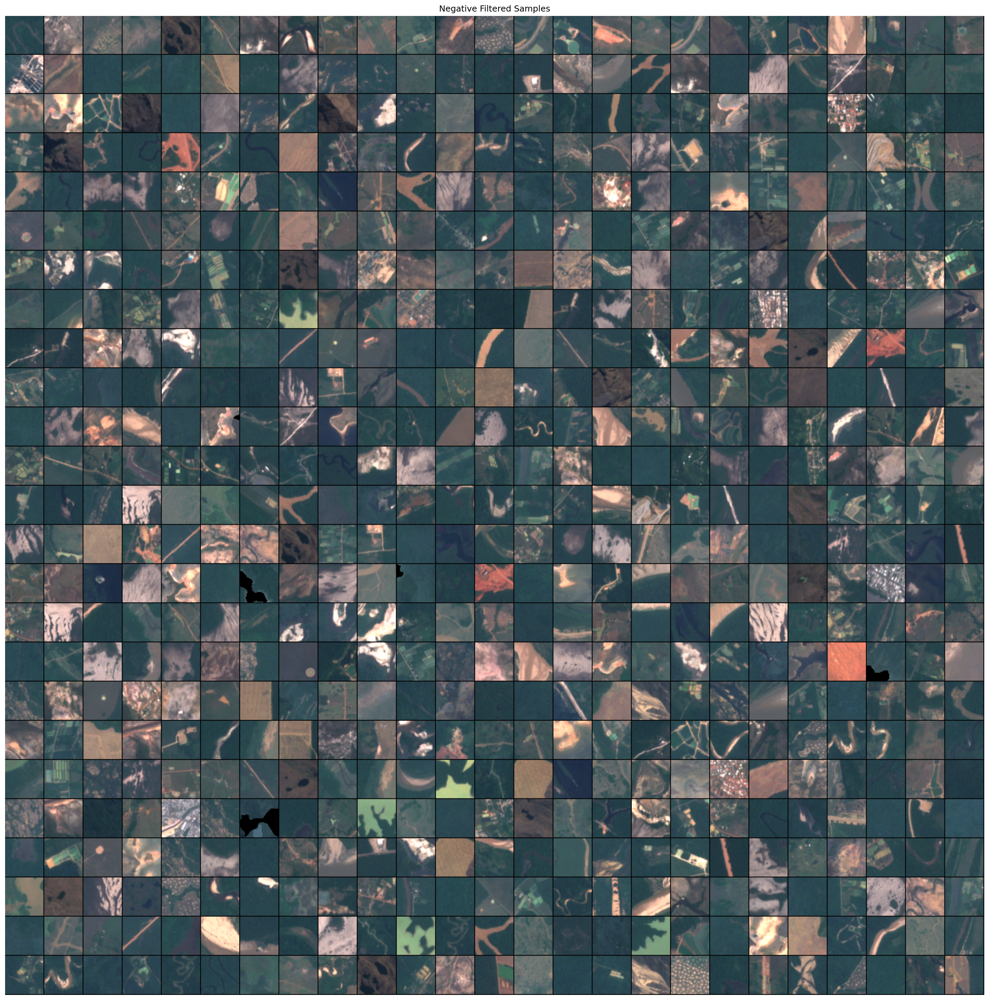

In [7]:
filtered_negatives, negative_rejects = filter_black(negative_patches, mask_limit = 0.6, return_rejects=True)
if len(negative_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(negative_rejects), num_samples)
    viz_tools.plot_numpy_grid(negative_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Negative Mask Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_negatives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_negatives[indices,:,:,3:0:-1] / 3000)
plt.title('Negative Filtered Samples')
plt.show()

## Prepare Data for Training

In [8]:
#for RGBIR, x = normalize(np.copy(images[:,:,:,[1,2,3,8]]))
x = np.concatenate((filtered_negatives, filtered_positives))
y = np.concatenate((np.zeros(len(filtered_negatives)), np.ones(len(filtered_positives))))
x, y = shuffle(x, y, random_state=33)

In [9]:
x_norm = np.clip(np.array(x.astype("float32") / 10000), 0, 1)

Seleccionamos el 10% del dataset para realizar el testeo de los modelos

In [10]:
dataset_size = len(y)
test_partition = int(dataset_size*0.1)

num_positive_samples_test = sum(y[:test_partition]==1)
num_negative_samples_test = sum(y[:test_partition]==0)

print(f"Número de clases positivas en el dataset de test {num_positive_samples_test}, número de clases negativas {num_negative_samples_test}")

x_norm = x_norm[:test_partition]
y = y[:test_partition]

Número de clases positivas en el dataset de test 185, número de clases negativas 269


# Evaluación Test y muestreo de los mejores hiperparámetros, métricas y número de parámetros entrenables.

In [11]:
input_shape = (48,48,12)

## Modelo original con parámetros originales

../notebooks/resultados/base_model/scratch_original_model_and_params_modelo_y_parametros_originales


2024-09-27 10:15:54.278208: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-09-27 10:15:54.351237: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-09-27 10:15:54.351272: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-09-27 10:15:54.353416: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-09-27 10:15:54.353451: I external/local_xla/xla/stream_executor

              precision    recall  f1-score   support

         0.0      0.937     0.993     0.964       269
         1.0      0.988     0.903     0.944       185

    accuracy                          0.956       454
   macro avg      0.963     0.948     0.954       454
weighted avg      0.958     0.956     0.956       454

Tiempo de inferencia medio: 0.209505 segundos
Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1,
          "1": 1
     },
     "batch_size": 32,
     "epochs": 160,
     "test_size": 0.3,
     "semilla": 969
}

El número de épocas para training 	 ---> 160 épocas.

Tiempo total empleado en el entrenamiento --> 7 min 16 segundos 



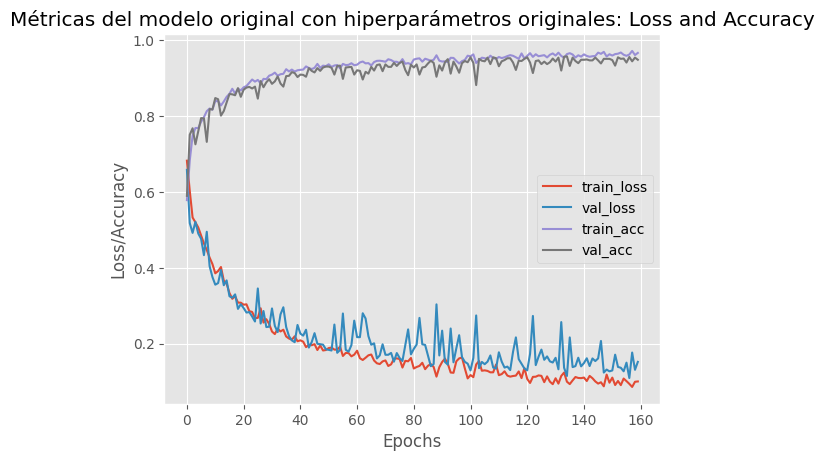


Número de parámetros entrenables

Total params: 116577 (0.44 MB)
Trainable params: 116577 (0.44 MB)
Non-trainable params: 0.0 (0.00 MB)


In [12]:
model_paths = dl_utils.get_best_results_paths("base_model")

print(model_paths['dir'])

tiempo_carga_inferencia = time.time()
modelo_y_parametros_originales = models.scratch_original_model(input_shape)
modelo_y_parametros_originales.load_weights(model_paths["weights"])
inferencia = time.time()

for i in range(0,10):
    dl_utils.evaluate_model(modelo_y_parametros_originales,x_norm,y,False,"modelo_y_parametros_originales",False)

dl_utils.evaluate_model(modelo_y_parametros_originales,x_norm,y,False,"modelo_y_parametros_originales")
tiempo_inferencia = (time.time() - inferencia)/10

print(f"Tiempo de inferencia medio: {tiempo_inferencia:.6f} segundos")

hiperparams_modelo_y_parametros_originales,best_modelo_y_parametros_originales_results = dl_utils.load_hiperparams_and_results(model_paths["hiperparams"],model_paths["metricas"])
print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_modelo_y_parametros_originales[0],indent=5)}\n")
print(f"El número de épocas para training \t ---> {hiperparams_modelo_y_parametros_originales[-1]} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {round(hiperparams_modelo_y_parametros_originales[-2])//60} min {round(hiperparams_modelo_y_parametros_originales[-2])%60} segundos \n")
dl_utils.grafica_accuracy(best_modelo_y_parametros_originales_results,"del modelo original con hiperparámetros originales", hiperparams_modelo_y_parametros_originales[-1])
print(f"\nNúmero de parámetros entrenables\n")
params_entrenables = dl_utils.get_total_params(models.scratch_original_model(input_shape))

base_model = ["Base Model",tiempo_inferencia, hiperparams_modelo_y_parametros_originales,pd.read_csv(model_paths["resultados"]),params_entrenables]

## AlexNet from scratch model

../notebooks/resultados/alexnet/alexnet_split_20_max_patience
              precision    recall  f1-score   support

         0.0      0.974     0.967     0.970       269
         1.0      0.952     0.962     0.957       185

    accuracy                          0.965       454
   macro avg      0.963     0.964     0.964       454
weighted avg      0.965     0.965     0.965       454

Tiempo de inferencia medio: 0.260163 segundos
Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 0.8568438677270824,
          "1": 1.2005865102639297
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 20,
     "patience_reduce_lr": 10,
     "test_size": 0.2,
     "semilla": 1423
}

El número de épocas para training 	 ---> 101 épocas.

Tiempo total empleado en el entrenamiento --> 5 min 58 segundos 



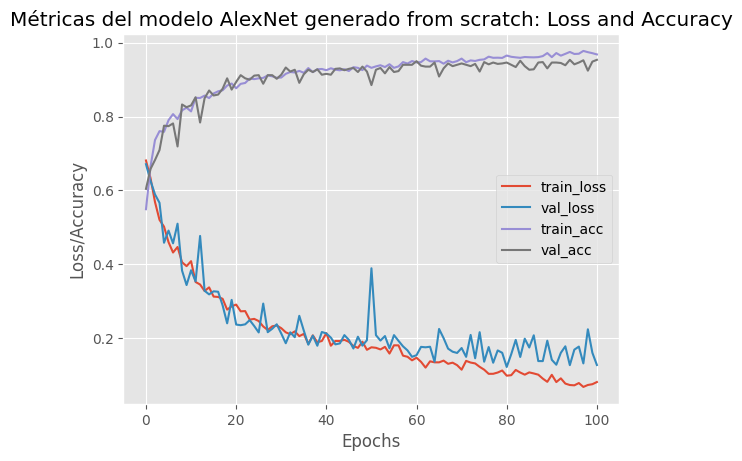


Número de parámetros entrenables

Total params: 10427873 (39.78 MB)
Trainable params: 10427873 (39.78 MB)
Non-trainable params: 0.0 (0.00 MB)


In [13]:
model_paths = dl_utils.get_best_results_paths("alexnet")

print(model_paths['dir'])

tiempo_carga_inferencia = time.time()
alexnet_model = models.alexnet_model(input_shape)
alexnet_model.load_weights(model_paths["weights"])
inferencia = time.time()

for i in range(0,9):
    dl_utils.evaluate_model(alexnet_model,x_norm,y,False,"alexnet",False)
    
dl_utils.evaluate_model(alexnet_model,x_norm,y,False,"alexnet")
tiempo_inferencia = (time.time() - inferencia)/10

print(f"Tiempo de inferencia medio: {tiempo_inferencia:.6f} segundos")

hiperparams_alexnet, metricas_alexnet = dl_utils.load_hiperparams_and_results(model_paths["hiperparams"],model_paths["metricas"])
print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_alexnet[0],indent=5)}\n")
print(f"El número de épocas para training \t ---> {hiperparams_alexnet[-1]} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {round(hiperparams_alexnet[-2])//60} min {round(hiperparams_alexnet[-2])%60} segundos \n")
dl_utils.grafica_accuracy(metricas_alexnet,"del modelo AlexNet generado from scratch",hiperparams_alexnet[-1])

print(f"\nNúmero de parámetros entrenables\n")
params_entrenables = dl_utils.get_total_params(models.alexnet_model(input_shape))

alexnet_model_data = ["AlexNet",tiempo_inferencia, hiperparams_alexnet,pd.read_csv(model_paths["resultados"]),params_entrenables]

## From scratch modified model (se aumenta el número de filtros del modelo original)

../notebooks/resultados/scratch_modified/scratch_modified_model_split_20_max_patience
              precision    recall  f1-score   support

         0.0      0.974     0.989     0.982       269
         1.0      0.983     0.962     0.973       185

    accuracy                          0.978       454
   macro avg      0.979     0.976     0.977       454
weighted avg      0.978     0.978     0.978       454

Tiempo de inferencia medio: 0.222765 segundos
Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1,
          "1": 1
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 20,
     "patience_reduce_lr": 10,
     "test_size": 0.2,
     "semilla": 231
}

El número de épocas para training 	 ---> 127 épocas.

Tiempo total empleado en el entrenamiento --> 7 min 26 segundos 



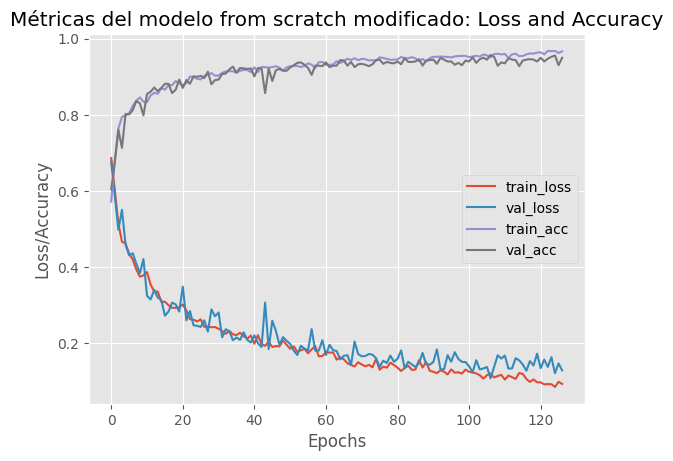


Número de parámetros entrenables

Total params: 1929281 (7.36 MB)
Trainable params: 1929281 (7.36 MB)
Non-trainable params: 0.0 (0.00 MB)


In [14]:
model_paths = dl_utils.get_best_results_paths("scratch_modified_model")

print(model_paths['dir'])

tiempo_carga_inferencia = time.time()
scratch_modified_model = models.scratch_modified_model(input_shape)
scratch_modified_model.load_weights(model_paths["weights"])
inferencia = time.time()
for i in range(0,9):
    dl_utils.evaluate_model(scratch_modified_model,x_norm,y,False,"scratch_modified_model",False)
    
dl_utils.evaluate_model(scratch_modified_model,x_norm,y,False,"scratch_modified_model")

tiempo_inferencia = (time.time() - inferencia)/10

print(f"Tiempo de inferencia medio: {tiempo_inferencia:.6f} segundos")

hiperparams_scratch_modified,best_scratch_modified_results = dl_utils.load_hiperparams_and_results(model_paths["hiperparams"],model_paths["metricas"])

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_scratch_modified[0],indent=5)}\n")
print(f"El número de épocas para training \t ---> {hiperparams_scratch_modified[-1]} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {round(hiperparams_scratch_modified[-2])//60} min {round(hiperparams_scratch_modified[-2])%60} segundos \n")
dl_utils.grafica_accuracy(best_scratch_modified_results,"del modelo from scratch modificado",hiperparams_scratch_modified[-1])

print(f"\nNúmero de parámetros entrenables\n")
params_entrenables = dl_utils.get_total_params(models.scratch_modified_model(input_shape))


scratch_modified_model_data = ["Scratch Modified Model",tiempo_inferencia, hiperparams_scratch_modified,pd.read_csv(model_paths["resultados"]),params_entrenables]

## Fine-tunning con VGG16 - Flatten

../notebooks/resultados/vgg_Flatten/vgg16_split_20_increase_patience
              precision    recall  f1-score   support

         0.0      0.960     0.974     0.967       269
         1.0      0.961     0.941     0.951       185

    accuracy                          0.960       454
   macro avg      0.961     0.957     0.959       454
weighted avg      0.960     0.960     0.960       454

Tiempo de inferencia medio: 0.363430 segundos
Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1,
          "1": 1
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping"
     ],
     "patience_early_stopping": 14,
     "patience_reduce_lr": 8,
     "test_size": 0.2,
     "semilla": 271
}

El número de épocas para training 	 ---> 60 épocas.

Tiempo total empleado en el entrenamiento --> 3 min 40 segundos 



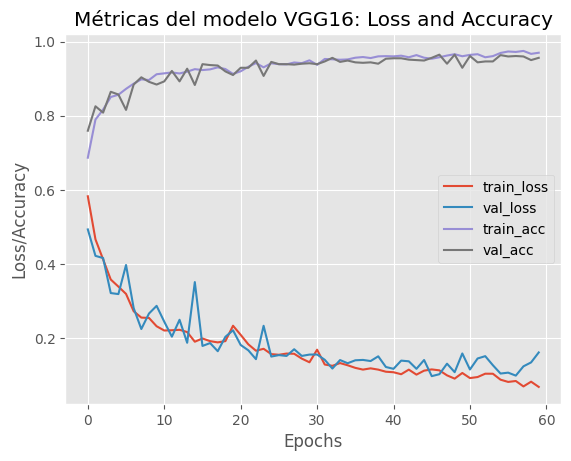


Número de parámetros entrenables

Total params: 15507841 (59.16 MB)
Trainable params: 8132737 (31.02 MB)
Non-trainable params: 7375104 (28.13 MB)


In [15]:
model_paths = dl_utils.get_best_results_paths("vgg_Flatten")

print(model_paths['dir'])

first_top_model_layer = "Flatten"

tiempo_carga_inferencia = time.time()
vgg16 = models.vgg_16_model(input_shape,first_top_model_layer)
vgg16.load_weights(model_paths["weights"])
inferencia = time.time()
for i in range(0,9):
    dl_utils.evaluate_model(vgg16,x_norm,y,False,"vgg16",False)
    
dl_utils.evaluate_model(vgg16,x_norm,y,False,"vgg16")
tiempo_inferencia = (time.time() - inferencia)/10

print(f"Tiempo de inferencia medio: {tiempo_inferencia:.6f} segundos")

hiperparams_vgg,best_vgg_results = dl_utils.load_hiperparams_and_results(model_paths["hiperparams"],model_paths["metricas"])

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_vgg[0],indent=5)}\n")
print(f"El número de épocas para training \t ---> {hiperparams_vgg[-1]} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {round(hiperparams_vgg[-2])//60} min {round(hiperparams_vgg[-2])%60} segundos \n")
dl_utils.grafica_accuracy(best_vgg_results,"del modelo VGG16",hiperparams_vgg[-1])

print(f"\nNúmero de parámetros entrenables\n")
params_entrenables=dl_utils.get_total_params(models.vgg_16_model(input_shape,first_top_model_layer))
vgg16_flatten_model_data = ["VGG16 con Flatten",tiempo_inferencia, hiperparams_vgg,pd.read_csv(model_paths["resultados"]),params_entrenables]

## Fine-tunning con VGG16 - GlobalMaxPooling

../notebooks/resultados/vgg_GlobalMaxPooling/vgg16_split_20_max_patience
              precision    recall  f1-score   support

         0.0      0.981     0.970     0.976       269
         1.0      0.957     0.973     0.965       185

    accuracy                          0.971       454
   macro avg      0.969     0.972     0.970       454
weighted avg      0.972     0.971     0.971       454

Tiempo de inferencia medio: 0.153334 segundos
Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 0.8568438677270824,
          "1": 1.2005865102639297
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 20,
     "test_size": 0.2,
     "semilla": 1880
}

El número de épocas para training 	 ---> 102 épocas.

Tiempo total empleado en el entrenamiento --> 6 min 8 segundos 



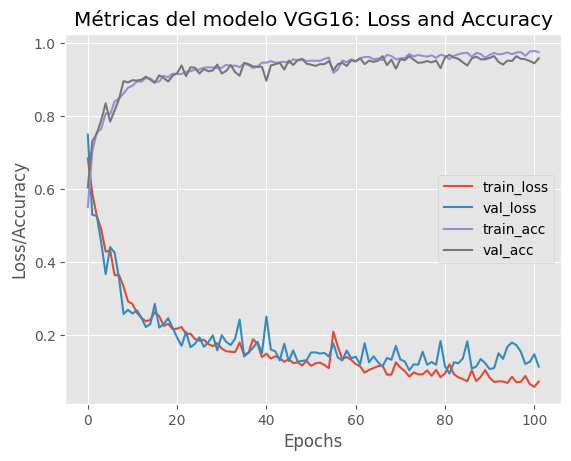


Número de parámetros entrenables

Total params: 15507841 (59.16 MB)
Trainable params: 8132737 (31.02 MB)
Non-trainable params: 7375104 (28.13 MB)


In [16]:
model_paths = dl_utils.get_best_results_paths("vgg_GlobalMaxPooling")

print(model_paths['dir'])

first_top_model_layer = "GlobalMaxPooling"

tiempo_carga_inferencia = time.time()
vgg16 = models.vgg_16_model(input_shape,first_top_model_layer)
vgg16.load_weights(model_paths["weights"])
inferencia = time.time()
for i in range(0,9):
    dl_utils.evaluate_model(vgg16,x_norm,y,False,"vgg16",False)
    
dl_utils.evaluate_model(vgg16,x_norm,y,False,"vgg16")
tiempo_inferencia = (time.time() - inferencia)/10

print(f"Tiempo de inferencia medio: {tiempo_inferencia:.6f} segundos")

hiperparams_vgg,best_vgg_results = dl_utils.load_hiperparams_and_results(model_paths["hiperparams"],model_paths["metricas"])

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_vgg[0],indent=5)}\n")
print(f"El número de épocas para training \t ---> {hiperparams_vgg[-1]} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {round(hiperparams_vgg[-2])//60} min {round(hiperparams_vgg[-2])%60} segundos \n")
dl_utils.grafica_accuracy(best_vgg_results,"del modelo VGG16",hiperparams_vgg[-1])

print(f"\nNúmero de parámetros entrenables\n")
params_entrenables=dl_utils.get_total_params(models.vgg_16_model(input_shape,first_top_model_layer))
vgg16_GlobalMaxPooling_model_data = ["VGG16 con GlobalMaxPooling",tiempo_inferencia, hiperparams_vgg,pd.read_csv(model_paths["resultados"]),params_entrenables]

## Fine-tunning con VGG16 - GlobalAveragePooling

../notebooks/resultados/vgg_GlobalAveragePooling/vgg16_split_20_max_patience
              precision    recall  f1-score   support

         0.0      0.967     0.985     0.976       269
         1.0      0.978     0.951     0.964       185

    accuracy                          0.971       454
   macro avg      0.972     0.968     0.970       454
weighted avg      0.971     0.971     0.971       454

Tiempo de inferencia medio: 0.157041 segundos
Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 0.8568438677270824,
          "1": 1.2005865102639297
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 20,
     "patience_reduce_lr": 10,
     "test_size": 0.2,
     "semilla": 1423
}

El número de épocas para training 	 ---> 84 épocas.

Tiempo total empleado en el entrenamiento --> 5 min 3 segundos 



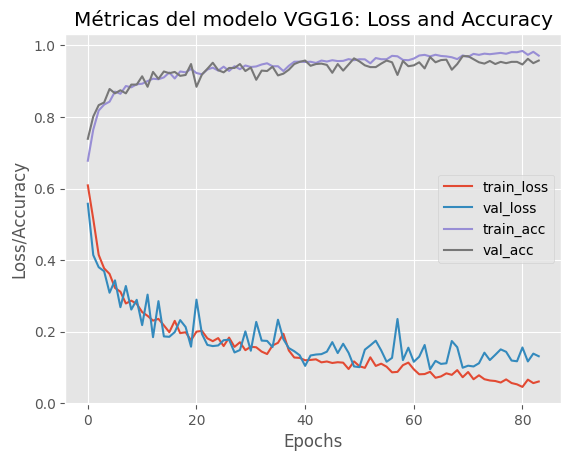


Número de parámetros entrenables

Total params: 15507841 (59.16 MB)
Trainable params: 8132737 (31.02 MB)
Non-trainable params: 7375104 (28.13 MB)


In [17]:
model_paths = dl_utils.get_best_results_paths("vgg_GlobalAveragePooling")

print(model_paths['dir'])

first_top_model_layer = "GlobalAveragePooling"

tiempo_carga_inferencia = time.time()
vgg16 = models.vgg_16_model(input_shape,first_top_model_layer)
vgg16.load_weights(model_paths["weights"])
inferencia = time.time()
for i in range(0,9):
    dl_utils.evaluate_model(vgg16,x_norm,y,False,"vgg16",False)
    
dl_utils.evaluate_model(vgg16,x_norm,y,False,"vgg16")
tiempo_inferencia = (time.time() - inferencia)/10

print(f"Tiempo de inferencia medio: {tiempo_inferencia:.6f} segundos")

hiperparams_vgg,best_vgg_results = dl_utils.load_hiperparams_and_results(model_paths["hiperparams"],model_paths["metricas"])

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_vgg[0],indent=5)}\n")
print(f"El número de épocas para training \t ---> {hiperparams_vgg[-1]} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {round(hiperparams_vgg[-2])//60} min {round(hiperparams_vgg[-2])%60} segundos \n")
dl_utils.grafica_accuracy(best_vgg_results,"del modelo VGG16",hiperparams_vgg[-1])

print(f"\nNúmero de parámetros entrenables\n")
params_entrenables=dl_utils.get_total_params(models.vgg_16_model(input_shape,first_top_model_layer))
vgg16_GlobalAveragePooling_model_data = ["VGG16 con GlobalAveragePooling",tiempo_inferencia, hiperparams_vgg,pd.read_csv(model_paths["resultados"]),params_entrenables]

## Fine-tunning MobileNet - Flatten

../notebooks/resultados/mobilenet_Flatten/mobile_net_split_30_max_patience
              precision    recall  f1-score   support

         0.0      0.974     0.967     0.970       269
         1.0      0.952     0.962     0.957       185

    accuracy                          0.965       454
   macro avg      0.963     0.964     0.964       454
weighted avg      0.965     0.965     0.965       454

Tiempo de inferencia medio es de: 0.541822 segundos
Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1,
          "1": 1
     },
     "batch_size": 16,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping"
     ],
     "patience_early_stopping": 20,
     "patience_reduce_lr": 10,
     "test_size": 0.3,
     "semilla": 305
}

El número de épocas para training 	 ---> 58 épocas.

Tiempo total empleado en el entrenamiento --> 3 min 32 segundos 



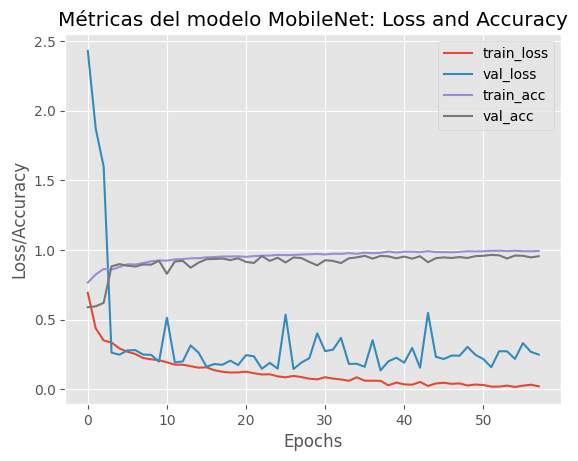


Número de parámetros entrenables

Total params: 12932353 (49.33 MB)
Trainable params: 11596801 (44.24 MB)
Non-trainable params: 1335552 (5.09 MB)


In [18]:
model_paths = dl_utils.get_best_results_paths("mobilenet_Flatten")

print(model_paths['dir'])

first_top_model_layer = "Flatten"

tiempo_carga_inferencia = time.time()
mobile_net = models.mobilenet_model(input_shape,first_top_model_layer)
mobile_net.load_weights(model_paths["weights"])
inferencia = time.time()
for i in range(0,9):
    dl_utils.evaluate_model(mobile_net,x_norm,y,False,"mobile_net",False)

dl_utils.evaluate_model(mobile_net,x_norm,y,False,"mobile_net")
tiempo_inferencia = (time.time() - inferencia)/10

tiempo_carga_inferencia = time.time() - tiempo_carga_inferencia
print(f"Tiempo de inferencia medio es de: {tiempo_inferencia:.6f} segundos")

hiperparams_mobilenet,best_mobilenet_results = dl_utils.load_hiperparams_and_results(model_paths["hiperparams"],model_paths["metricas"])

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_mobilenet[0],indent=5)}\n")
print(f"El número de épocas para training \t ---> {hiperparams_mobilenet[-1]} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {round(hiperparams_mobilenet[-2])//60} min {round(hiperparams_mobilenet[-2])%60} segundos \n")
dl_utils.grafica_accuracy(best_mobilenet_results,"del modelo MobileNet",hiperparams_mobilenet[-1])

print(f"\nNúmero de parámetros entrenables\n")
params_entrenables=dl_utils.get_total_params(models.mobilenet_model(input_shape,first_top_model_layer))
mobilenet_flatten_model_data = ["MobileNet con Flatten",tiempo_inferencia, hiperparams_mobilenet,pd.read_csv(model_paths["resultados"]),params_entrenables]

## Fine-tunning MobileNet - GlobalMaxPooling

../notebooks/resultados/mobilenet_GlobalMaxPooling/mobile_net_split_20_max_patience
              precision    recall  f1-score   support

         0.0      0.985     0.955     0.970       269
         1.0      0.938     0.978     0.958       185

    accuracy                          0.965       454
   macro avg      0.961     0.967     0.964       454
weighted avg      0.966     0.965     0.965       454

Tiempo de inferencia medio es de: 0.242858 segundos
Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 0.8568438677270824,
          "1": 1.2005865102639297
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 20,
     "patience_reduce_lr": 10,
     "test_size": 0.2,
     "semilla": 1538
}

El número de épocas para training 	 ---> 99 épocas.

Tiempo total empleado en el entrenamiento --> 6 min 1 segundos 



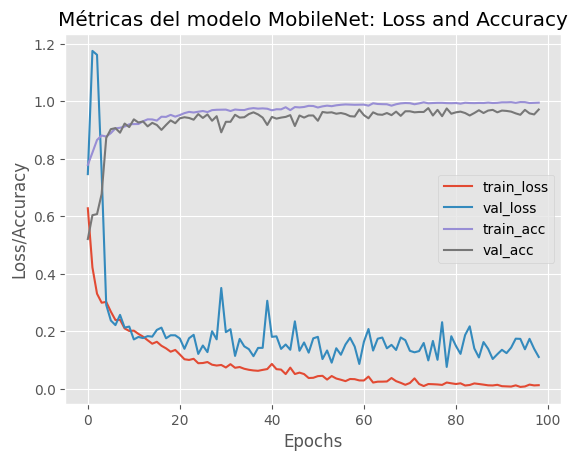


Número de parámetros entrenables

Total params: 4543745 (17.33 MB)
Trainable params: 3208193 (12.24 MB)
Non-trainable params: 1335552 (5.09 MB)


In [19]:
model_paths = dl_utils.get_best_results_paths("mobilenet_GlobalMaxPooling")

print(model_paths['dir'])

first_top_model_layer = "GlobalMaxPooling"

tiempo_carga_inferencia = time.time()
mobile_net = models.mobilenet_model(input_shape,first_top_model_layer)
mobile_net.load_weights(model_paths["weights"])
inferencia = time.time()
for i in range(0,9):
    dl_utils.evaluate_model(mobile_net,x_norm,y,False,"mobile_net",False)

dl_utils.evaluate_model(mobile_net,x_norm,y,False,"mobile_net")
tiempo_inferencia = (time.time() - inferencia)/10

tiempo_carga_inferencia = time.time() - tiempo_carga_inferencia
print(f"Tiempo de inferencia medio es de: {tiempo_inferencia:.6f} segundos")

hiperparams_mobilenet,best_mobilenet_results = dl_utils.load_hiperparams_and_results(model_paths["hiperparams"],model_paths["metricas"])

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_mobilenet[0],indent=5)}\n")
print(f"El número de épocas para training \t ---> {hiperparams_mobilenet[-1]} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {round(hiperparams_mobilenet[-2])//60} min {round(hiperparams_mobilenet[-2])%60} segundos \n")
dl_utils.grafica_accuracy(best_mobilenet_results,"del modelo MobileNet",hiperparams_mobilenet[-1])

print(f"\nNúmero de parámetros entrenables\n")
params_entrenables=dl_utils.get_total_params(models.mobilenet_model(input_shape,first_top_model_layer))
mobilenet_GlobalMaxPooling_model_data = ["MobileNet con GlobalMaxPooling",tiempo_inferencia, hiperparams_mobilenet,pd.read_csv(model_paths["resultados"]),params_entrenables]

## Fine-tunning MobileNet - GlobalAveragePooling

../notebooks/resultados/mobilenet_GlobalAveragePooling/mobile_net_split_20_increase_patience
              precision    recall  f1-score   support

         0.0      0.957     0.985     0.971       269
         1.0      0.977     0.935     0.956       185

    accuracy                          0.965       454
   macro avg      0.967     0.960     0.963       454
weighted avg      0.965     0.965     0.965       454

Tiempo de inferencia medio es de: 0.257628 segundos
Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1,
          "1": 1
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 14,
     "test_size": 0.2,
     "semilla": 1155
}

El número de épocas para training 	 ---> 40 épocas.

Tiempo total empleado en el entrenamiento --> 2 min 27 segundos 



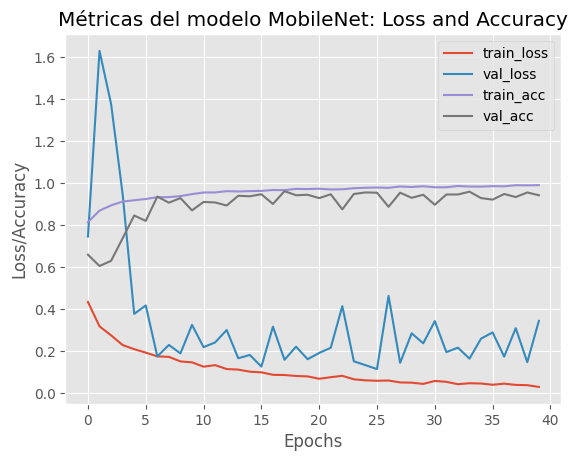


Número de parámetros entrenables

Total params: 4543745 (17.33 MB)
Trainable params: 3208193 (12.24 MB)
Non-trainable params: 1335552 (5.09 MB)


In [20]:
model_paths = dl_utils.get_best_results_paths("mobilenet_GlobalAveragePooling")

print(model_paths['dir'])

first_top_model_layer = "GlobalAveragePooling"

tiempo_carga_inferencia = time.time()
mobile_net = models.mobilenet_model(input_shape,first_top_model_layer)
mobile_net.load_weights(model_paths["weights"])
inferencia = time.time()
for i in range(0,9):
    dl_utils.evaluate_model(mobile_net,x_norm,y,False,"mobile_net",False)

dl_utils.evaluate_model(mobile_net,x_norm,y,False,"mobile_net")
tiempo_inferencia = (time.time() - inferencia)/10

tiempo_carga_inferencia = time.time() - tiempo_carga_inferencia
print(f"Tiempo de inferencia medio es de: {tiempo_inferencia:.6f} segundos")

hiperparams_mobilenet,best_mobilenet_results = dl_utils.load_hiperparams_and_results(model_paths["hiperparams"],model_paths["metricas"])

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_mobilenet[0],indent=5)}\n")
print(f"El número de épocas para training \t ---> {hiperparams_mobilenet[-1]} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {round(hiperparams_mobilenet[-2])//60} min {round(hiperparams_mobilenet[-2])%60} segundos \n")
dl_utils.grafica_accuracy(best_mobilenet_results,"del modelo MobileNet",hiperparams_mobilenet[-1])

print(f"\nNúmero de parámetros entrenables\n")
params_entrenables=dl_utils.get_total_params(models.mobilenet_model(input_shape,first_top_model_layer))
mobilenet_GlobalAveragePooling_model_data = ["MobileNet con GlobalAveragePooling",tiempo_inferencia, hiperparams_mobilenet,pd.read_csv(model_paths["resultados"]),params_entrenables]

# Guardado de los datos

In [21]:
model_data_list = [base_model, alexnet_model_data, scratch_modified_model_data, vgg16_flatten_model_data, vgg16_GlobalMaxPooling_model_data, vgg16_GlobalAveragePooling_model_data, mobilenet_flatten_model_data, mobilenet_GlobalMaxPooling_model_data, mobilenet_GlobalAveragePooling_model_data]
with open('../notebooks/resultados/checkpoint_resultados.pkl', 'wb') as file:
    pickle.dump(model_data_list, file)